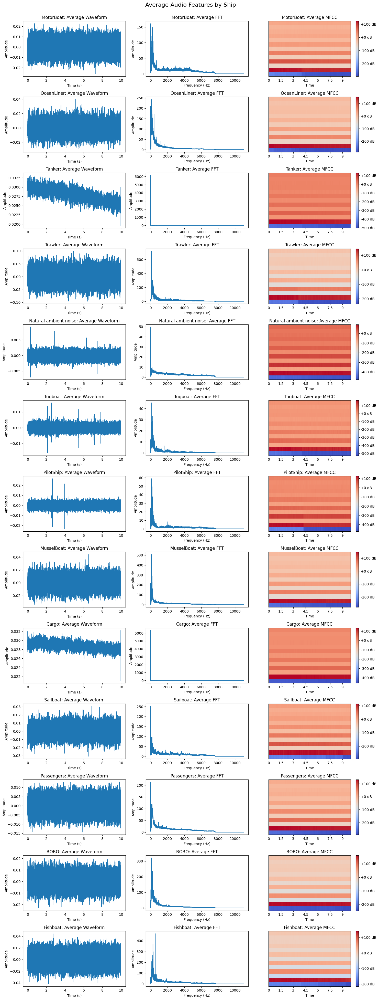

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import os

# ShipsEar-processed 디렉토리 경로
BASE_DIR = "Class_ShipsEar"

# 오디오 데이터를 불러오고 특징을 추출하여 시각화
def load_and_visualize_average_audio(base_dir, classes, sr=22050):
    fig, axes = plt.subplots(len(classes), 3, figsize=(15, len(classes) * 3))
    fig.suptitle("Average Audio Features by Ship", fontsize=16, y=1.0)

    for i, class_name in enumerate(classes):
        # 클래스 디렉토리 경로
        class_dir = os.path.join(base_dir, class_name)
        audio_files = [os.path.join(class_dir, f) for f in os.listdir(class_dir) if f.endswith('.wav')]

        if not audio_files:
            print(f"No audio files found in {class_dir}")
            continue
        
        # 각 파일의 데이터를 저장할 리스트
        all_signals = []
        all_fft = []
        all_mfccs = []
        max_length = 0  # 최대 신호 길이를 찾기 위한 초기값

        # 모든 파일 로드 및 최대 길이 확인
        for file in audio_files:
            signal, sr = librosa.load(file, sr=sr)
            max_length = max(max_length, len(signal))  # 최대 길이 갱신
            all_signals.append(signal)

        # 모든 신호를 최대 길이로 패딩
        all_signals = [np.pad(signal, (0, max_length - len(signal)), 'constant') for signal in all_signals]

        # FFT 및 MFCC 계산
        for signal in all_signals:
            fft = np.abs(np.fft.fft(signal))[:len(signal) // 2]
            mfccs = librosa.feature.mfcc(y=signal, sr=sr, n_mfcc=13)

            all_fft.append(fft)
            all_mfccs.append(mfccs)
        
        # 평균 계산
        avg_signal = np.mean(all_signals, axis=0)
        avg_fft = np.mean(all_fft, axis=0)
        avg_mfcc = np.mean(all_mfccs, axis=0)

        # 1. 평균 Waveform
        axes[i, 0].plot(np.linspace(0, len(avg_signal) / sr, len(avg_signal)), avg_signal)
        axes[i, 0].set_title(f"{class_name}: Average Waveform")
        axes[i, 0].set_xlabel("Time (s)")
        axes[i, 0].set_ylabel("Amplitude")

        # 2. 평균 FFT
        freqs = np.fft.fftfreq(len(avg_signal), 1 / sr)[:len(avg_signal) // 2]
        axes[i, 1].plot(freqs, avg_fft)
        axes[i, 1].set_title(f"{class_name}: Average FFT")
        axes[i, 1].set_xlabel("Frequency (Hz)")
        axes[i, 1].set_ylabel("Amplitude")

        # 3. 평균 MFCC
        img = librosa.display.specshow(avg_mfcc, x_axis='time', sr=sr, ax=axes[i, 2])
        fig.colorbar(img, ax=axes[i, 2], format="%+2.0f dB")
        axes[i, 2].set_title(f"{class_name}: Average MFCC")
    
    plt.tight_layout()
    plt.show()

# 클래스 이름 정의
classes = ["MotorBoat", "OceanLiner", "Tanker", "Trawler", "Natural ambient noise",
                "Tugboat", "PilotShip", "MusselBoat", "Cargo", "Sailboat",
                "Passengers", "RORO", "Fishboat"]

# 평균 시각화 함수 호출
load_and_visualize_average_audio(BASE_DIR, classes)


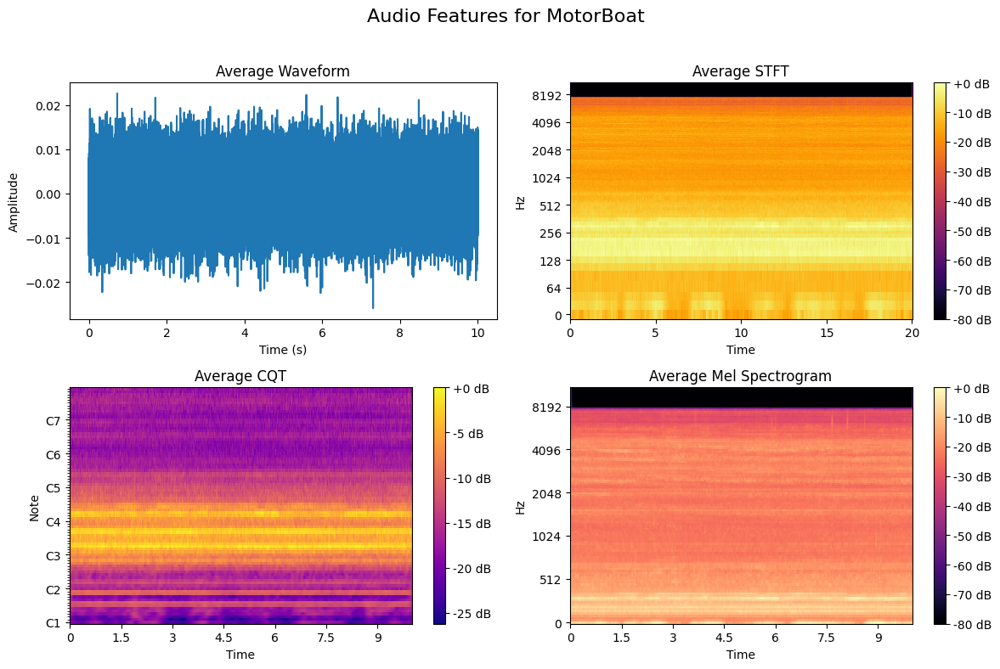

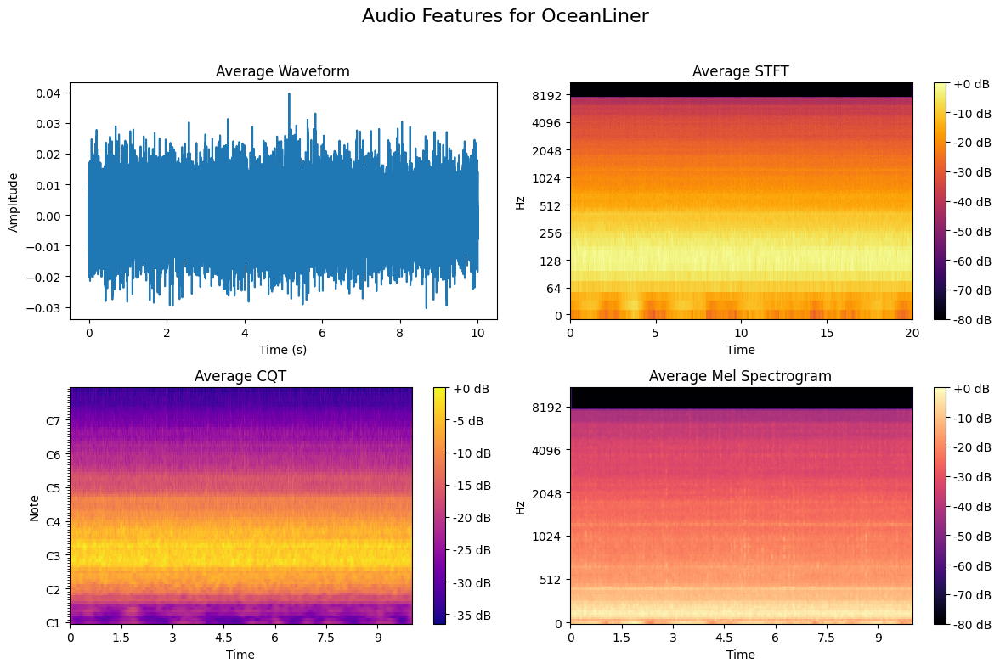

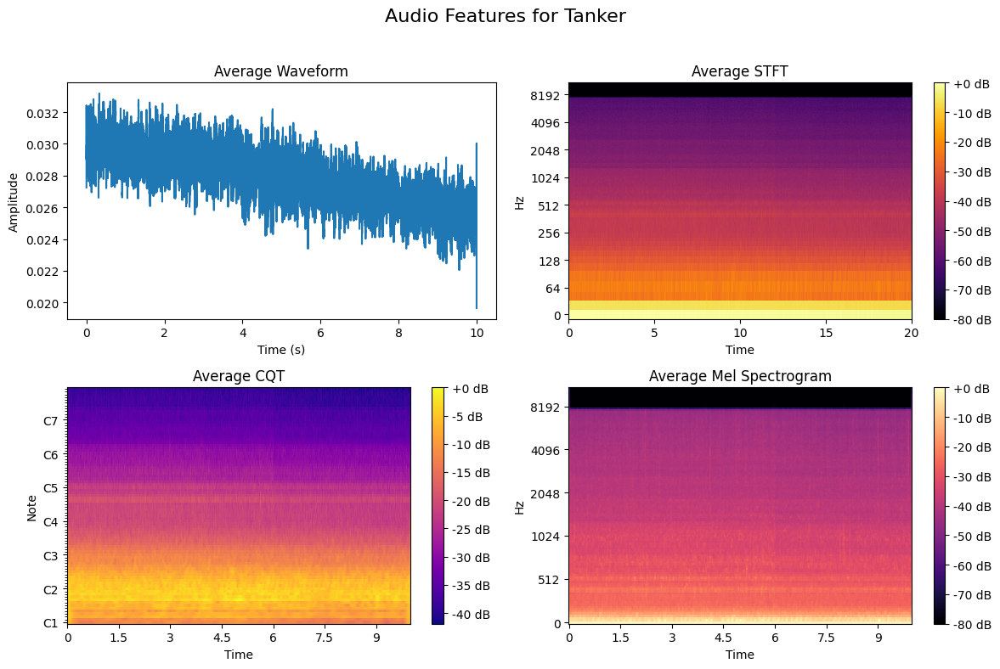

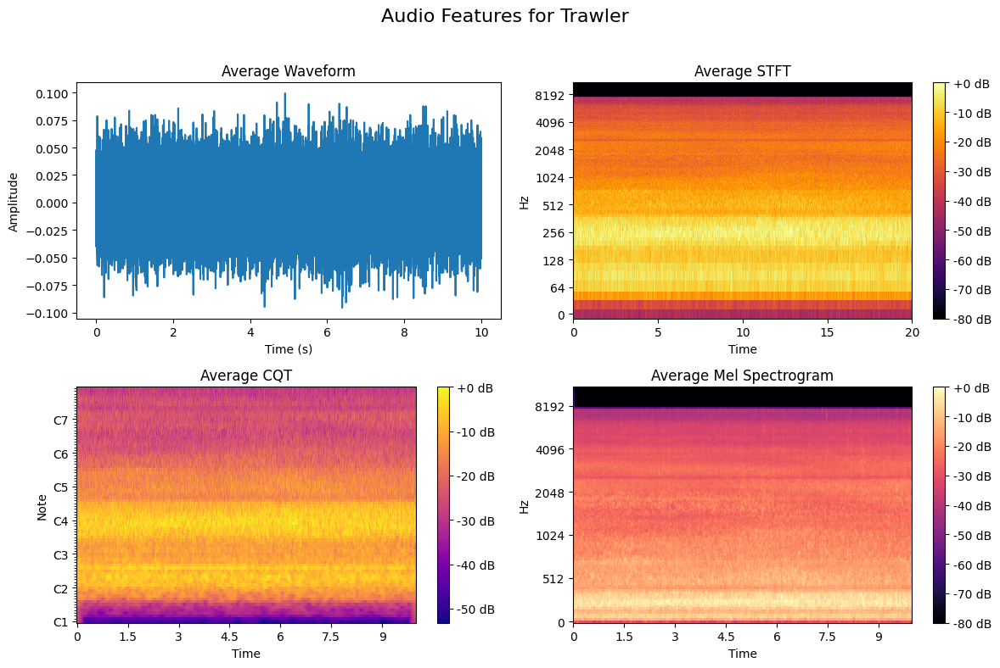

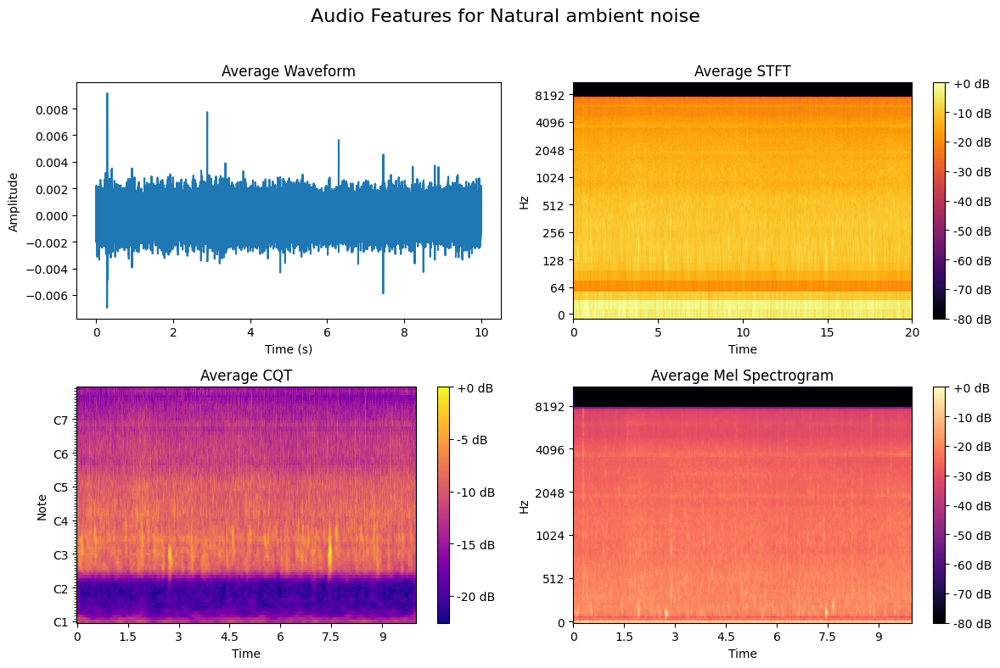

...

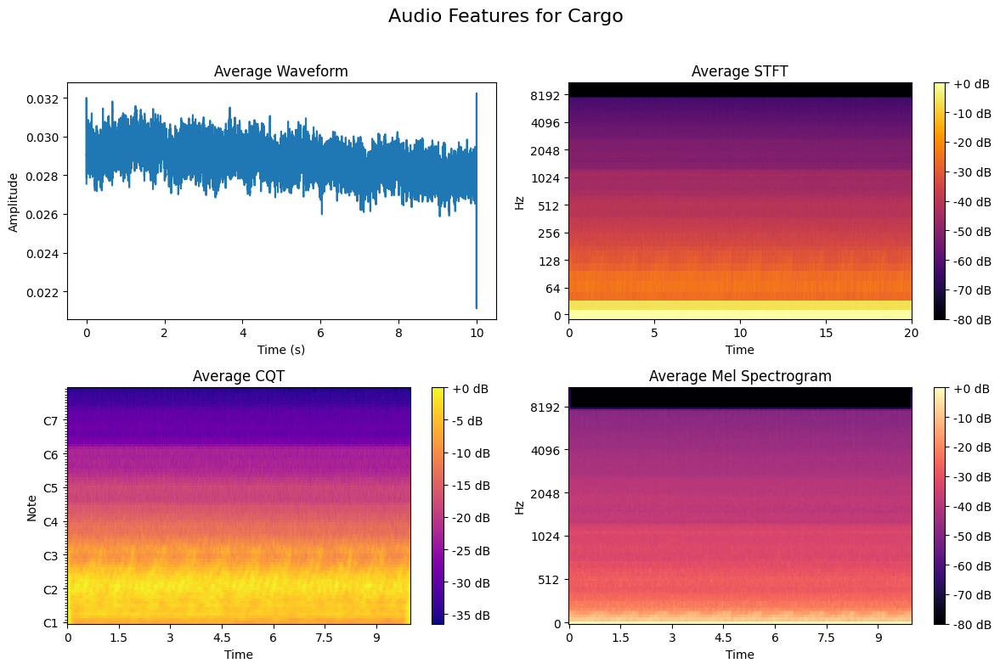

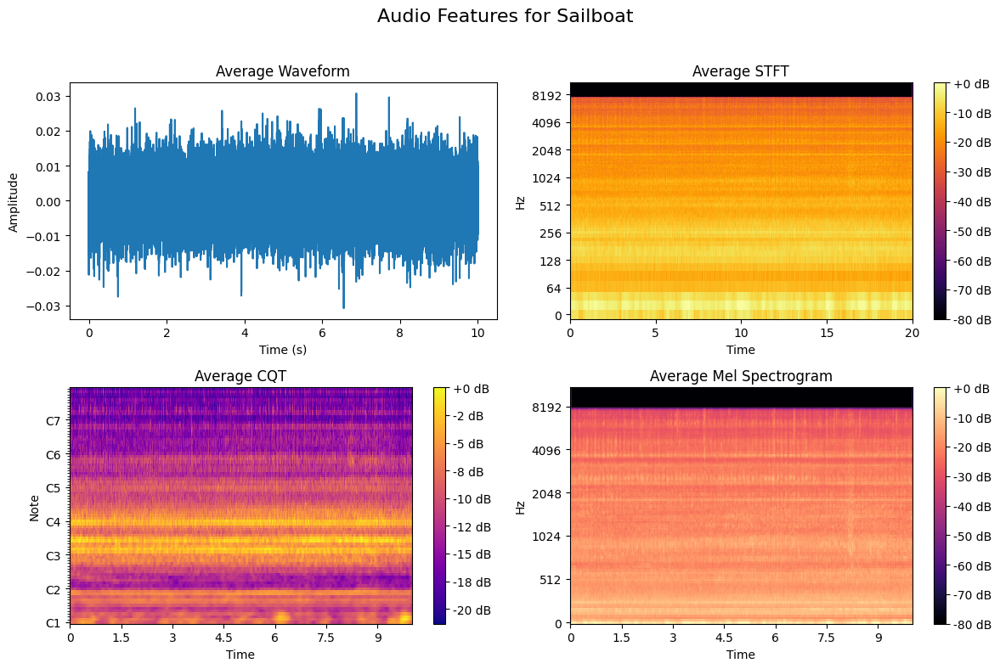

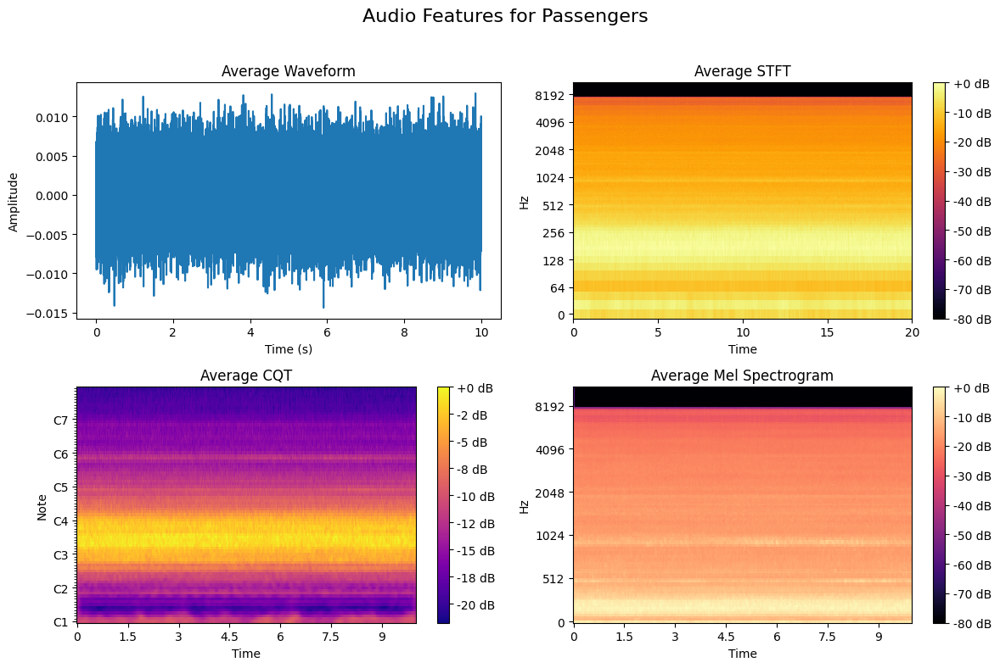

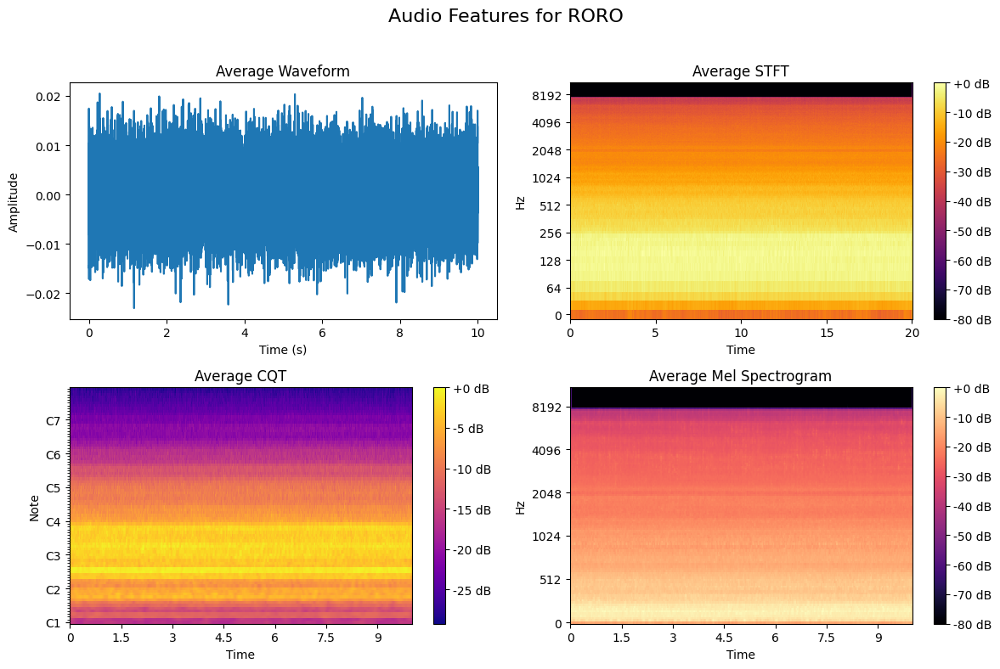

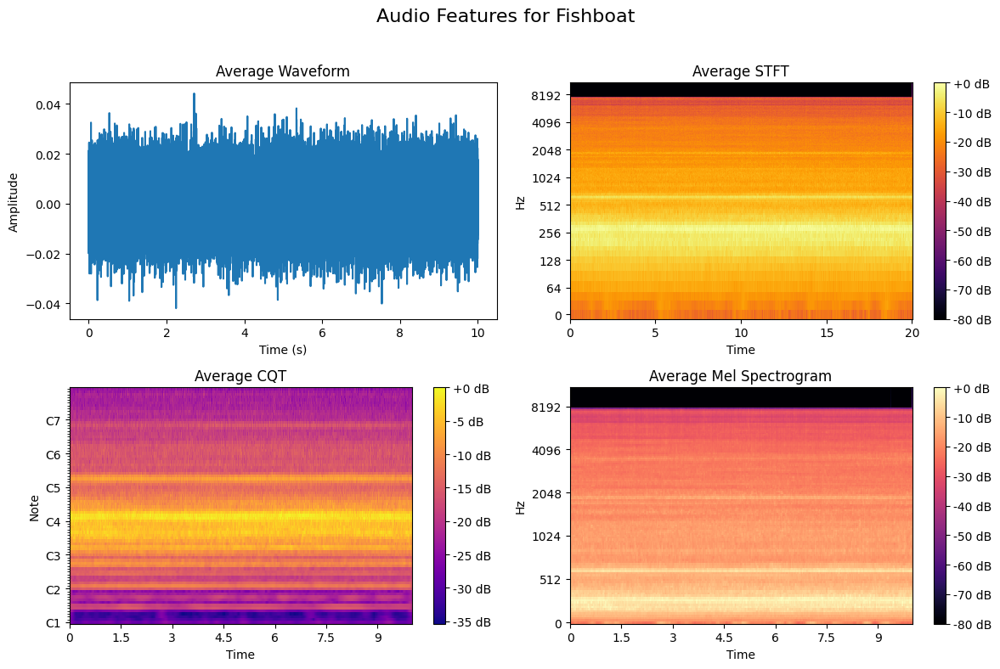

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import os

# ShipsEar-processed 디렉토리 경로
BASE_DIR = "Class_ShipsEar"

# 오디오 데이터를 불러오고 특징을 추출하여 시각화
def load_and_visualize_audio_features(base_dir, classes, sr=22050):
    for class_name in classes:
        # 클래스 디렉토리 경로
        class_dir = os.path.join(base_dir, class_name)
        audio_files = [os.path.join(class_dir, f) for f in os.listdir(class_dir) if f.endswith('.wav')]

        if not audio_files:
            print(f"No audio files found in {class_dir}")
            continue
        
        # 각 파일의 데이터를 저장할 리스트
        all_signals = []
        all_stft = []
        all_cqt = []
        all_mel = []
        max_length = 0  # 최대 신호 길이를 찾기 위한 초기값

        # 모든 파일 로드 및 최대 길이 확인
        for file in audio_files:
            signal, sr = librosa.load(file, sr=sr)
            max_length = max(max_length, len(signal))  # 최대 길이 갱신
            all_signals.append(signal)

        # 모든 신호를 최대 길이로 패딩
        all_signals = [np.pad(signal, (0, max_length - len(signal)), 'constant') for signal in all_signals]

        # STFT, CQT 및 MEL Spectrogram 계산
        for signal in all_signals:
            stft = np.abs(librosa.stft(signal, n_fft=1024))
            cqt = np.abs(librosa.cqt(signal, sr=sr, n_bins=84))
            mel = librosa.feature.melspectrogram(y=signal, sr=sr, n_mels=128)

            all_stft.append(stft)
            all_cqt.append(cqt)
            all_mel.append(mel)
        
        # 평균 계산
        avg_signal = np.mean(all_signals, axis=0)
        avg_stft = np.mean(all_stft, axis=0)
        avg_cqt = np.mean(all_cqt, axis=0)
        avg_mel = np.mean(all_mel, axis=0)

        # 2x2 시각화
        fig, axes = plt.subplots(2, 2, figsize=(12, 8))
        fig.suptitle(f"Audio Features for {class_name}", fontsize=16)

        # 1. 평균 Waveform
        axes[0, 0].plot(np.linspace(0, len(avg_signal) / sr, len(avg_signal)), avg_signal)
        axes[0, 0].set_title("Average Waveform")
        axes[0, 0].set_xlabel("Time (s)")
        axes[0, 0].set_ylabel("Amplitude")

        # 2. 평균 STFT
        img_stft = librosa.display.specshow(librosa.amplitude_to_db(avg_stft, ref=np.max), sr=sr, x_axis='time', y_axis='log', ax=axes[0, 1], cmap='inferno')
        fig.colorbar(img_stft, ax=axes[0, 1], format="%+2.0f dB")
        axes[0, 1].set_title("Average STFT")

        # 3. 평균 CQT
        img_cqt = librosa.display.specshow(librosa.amplitude_to_db(avg_cqt, ref=np.max), sr=sr, x_axis='time', y_axis='cqt_note', ax=axes[1, 0], cmap='plasma')
        fig.colorbar(img_cqt, ax=axes[1, 0], format="%+2.0f dB")
        axes[1, 0].set_title("Average CQT")

        # 4. 평균 Mel Spectrogram
        img_mel = librosa.display.specshow(librosa.power_to_db(avg_mel, ref=np.max), sr=sr, x_axis='time', y_axis='mel', ax=axes[1, 1])
        fig.colorbar(img_mel, ax=axes[1, 1], format="%+2.0f dB")
        axes[1, 1].set_title("Average Mel Spectrogram")

        
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()

# 클래스 이름 정의
classes = ["MotorBoat", "OceanLiner", "Tanker", "Trawler", "Natural ambient noise",
                "Tugboat", "PilotShip", "MusselBoat", "Cargo", "Sailboat",
                "Passengers", "RORO", "Fishboat"]

# 평균 시각화 함수 호출
load_and_visualize_audio_features(BASE_DIR, classes)


c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1482
  warnings.warn(
c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=101
  warnings.warn(


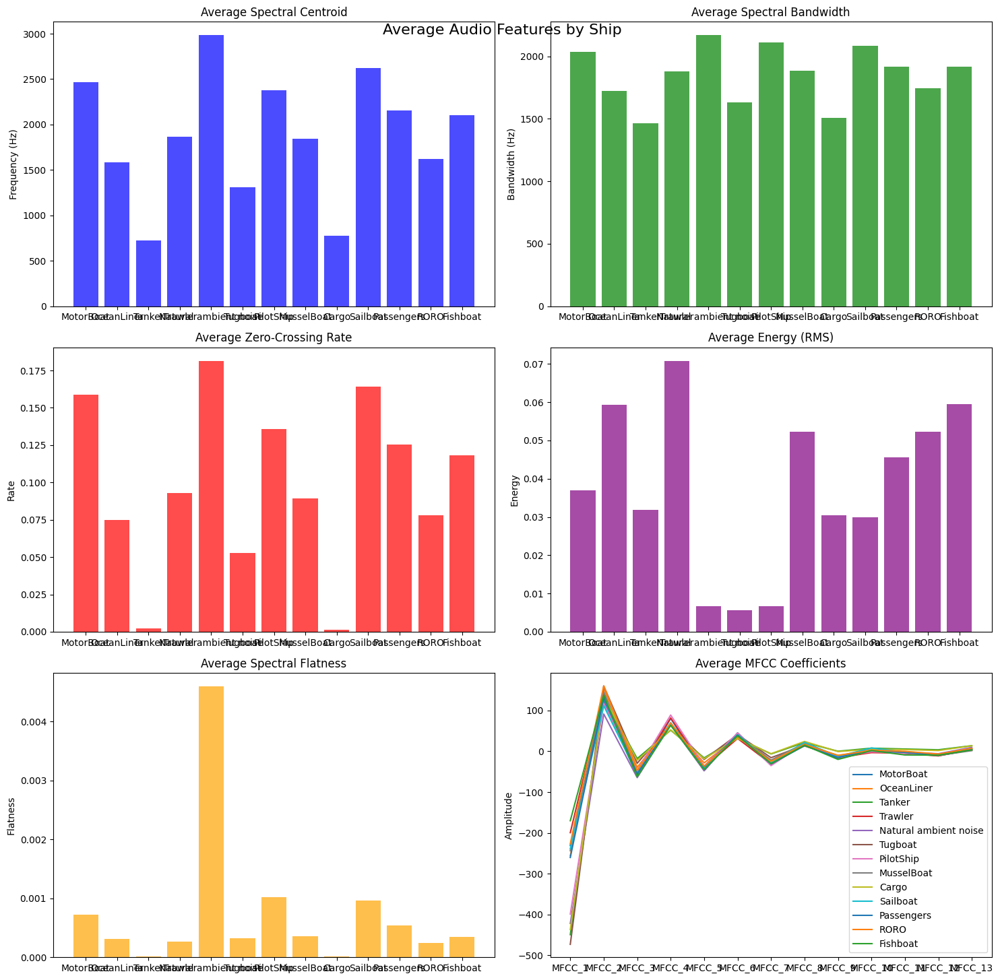

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import os

# ShipsEar-processed 디렉토리 경로
BASE_DIR = "Class_ShipsEar"

# 오디오 데이터를 불러오고 특징을 추출하여 시각화
def load_and_visualize_audio_features(base_dir, classes, sr=22050):
    avg_features = []  # 각 클래스의 평균 특성을 저장할 리스트

    for class_name in classes:
        # 클래스 디렉토리 경로
        class_dir = os.path.join(base_dir, class_name)
        audio_files = [os.path.join(class_dir, f) for f in os.listdir(class_dir) if f.endswith('.wav')]

        if not audio_files:
            print(f"No audio files found in {class_dir}")
            avg_features.append({"class": class_name, "centroid": 0, "bandwidth": 0, "zcr": 0, "mfcc": [0]*13, "energy": 0, "flatness": 0})
            continue
        
        # 모든 파일의 특징 저장
        all_centroids = []
        all_bandwidths = []
        all_zcrs = []
        all_mfccs = []
        all_energies = []
        all_flatness = []

        for file in audio_files:
            signal, sr = librosa.load(file, sr=sr)
            # 평균 주파수 (Spectral Centroid) 계산
            centroid = librosa.feature.spectral_centroid(y=signal, sr=sr)
            # 대역폭 (Spectral Bandwidth) 계산
            bandwidth = librosa.feature.spectral_bandwidth(y=signal, sr=sr)
            # ZCR (Zero-Crossing Rate) 계산
            zcr = librosa.feature.zero_crossing_rate(y=signal)
            # MFCC 계산
            mfccs = librosa.feature.mfcc(y=signal, sr=sr, n_mfcc=13)
            # 에너지 (Root Mean Square) 계산
            energy = librosa.feature.rms(y=signal)
            # 스펙트럼 평탄도 (Spectral Flatness) 계산
            flatness = librosa.feature.spectral_flatness(y=signal)

            all_centroids.append(np.mean(centroid))
            all_bandwidths.append(np.mean(bandwidth))
            all_zcrs.append(np.mean(zcr))
            all_mfccs.append(np.mean(mfccs, axis=1))
            all_energies.append(np.mean(energy))
            all_flatness.append(np.mean(flatness))

        # 클래스별 평균 계산
        avg_centroid = np.mean(all_centroids)
        avg_bandwidth = np.mean(all_bandwidths)
        avg_zcr = np.mean(all_zcrs)
        avg_mfcc = np.mean(all_mfccs, axis=0)
        avg_energy = np.mean(all_energies)
        avg_flatness = np.mean(all_flatness)

        avg_features.append({
            "class": class_name,
            "centroid": avg_centroid,
            "bandwidth": avg_bandwidth,
            "zcr": avg_zcr,
            "mfcc": avg_mfcc,
            "energy": avg_energy,
            "flatness": avg_flatness
        })

    # 시각화
    plot_audio_features(avg_features)

def plot_audio_features(avg_features):
    # 각 특징 시각화
    classes = [feature["class"] for feature in avg_features]
    centroids = [feature["centroid"] for feature in avg_features]
    bandwidths = [feature["bandwidth"] for feature in avg_features]
    zcrs = [feature["zcr"] for feature in avg_features]
    energies = [feature["energy"] for feature in avg_features]
    flatness = [feature["flatness"] for feature in avg_features]
    mfccs = [feature["mfcc"] for feature in avg_features]

    fig, axes = plt.subplots(3, 2, figsize=(15, 15))
    fig.suptitle("Average Audio Features by Ship", fontsize=16, y=0.95)

    # 평균 주파수 (Spectral Centroid)
    axes[0, 0].bar(classes, centroids, color='b', alpha=0.7)
    axes[0, 0].set_title("Average Spectral Centroid")
    axes[0, 0].set_ylabel("Frequency (Hz)")

    # 대역폭 (Spectral Bandwidth)
    axes[0, 1].bar(classes, bandwidths, color='g', alpha=0.7)
    axes[0, 1].set_title("Average Spectral Bandwidth")
    axes[0, 1].set_ylabel("Bandwidth (Hz)")

    # ZCR (Zero-Crossing Rate)
    axes[1, 0].bar(classes, zcrs, color='r', alpha=0.7)
    axes[1, 0].set_title("Average Zero-Crossing Rate")
    axes[1, 0].set_ylabel("Rate")

    # 에너지 (RMS)
    axes[1, 1].bar(classes, energies, color='purple', alpha=0.7)
    axes[1, 1].set_title("Average Energy (RMS)")
    axes[1, 1].set_ylabel("Energy")

    # 스펙트럼 평탄도 (Spectral Flatness)
    axes[2, 0].bar(classes, flatness, color='orange', alpha=0.7)
    axes[2, 0].set_title("Average Spectral Flatness")
    axes[2, 0].set_ylabel("Flatness")

    # MFCC 주요 계수
    mfcc_labels = [f"MFCC_{i+1}" for i in range(len(mfccs[0]))]
    for i, class_name in enumerate(classes):
        axes[2, 1].plot(mfcc_labels, mfccs[i], label=class_name)

    axes[2, 1].set_title("Average MFCC Coefficients")
    axes[2, 1].set_ylabel("Amplitude")
    axes[2, 1].legend()

    plt.tight_layout()
    plt.show()

# 클래스 이름 정의
classes = ["MotorBoat", "OceanLiner", "Tanker", "Trawler", "Natural ambient noise",
                "Tugboat", "PilotShip", "MusselBoat", "Cargo", "Sailboat",
                "Passengers", "RORO", "Fishboat"]
# 평균 시각화 함수 호출
load_and_visualize_audio_features(BASE_DIR, classes)


Visualizing features for MotorBoat: 103_chunk1.wav


C:\Users\nurul\AppData\Local\Temp\ipykernel_8280\1567343465.py:37: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  "CQT": librosa.amplitude_to_db(librosa.cqt(audio, sr=sr), ref=np.max),
c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\pitch.py:101: UserWarning: Trying to estimate tuning from empty frequency set.
  return pitch_tuning(


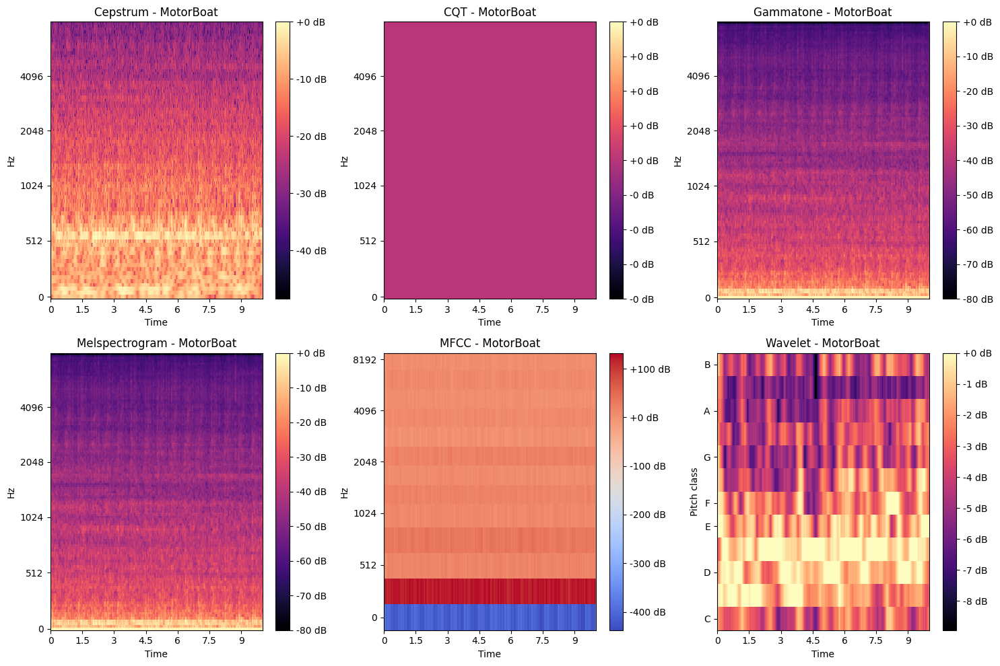

Visualizing features for OceanLiner: 73__23_07_13_H3_pesqMariCarmen_chunk1.wav


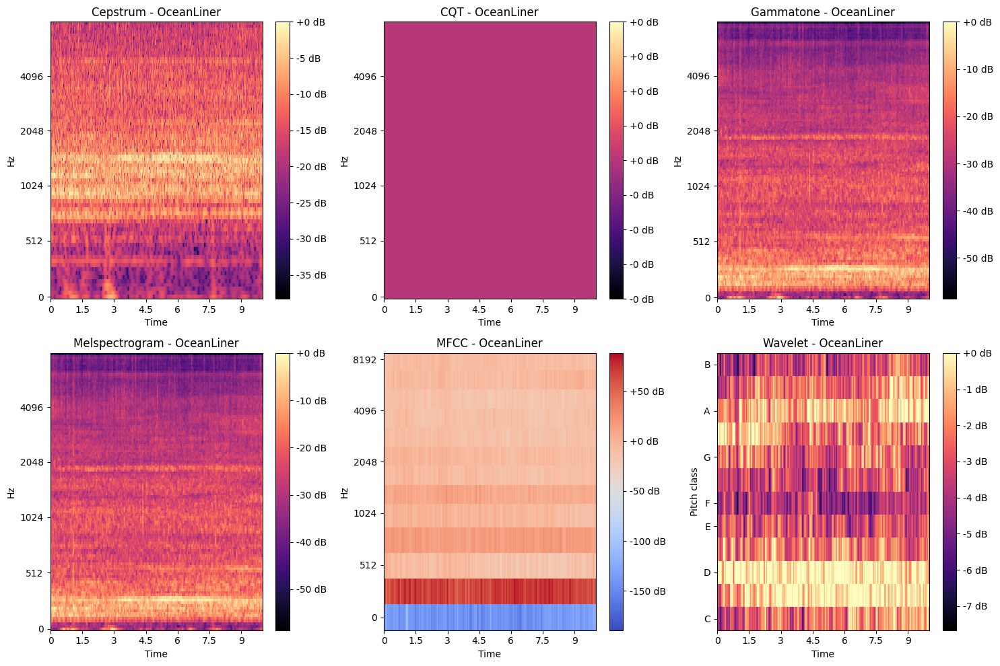

Visualizing features for Tanker: 26__19_07_13_Lancha_chunk1.wav


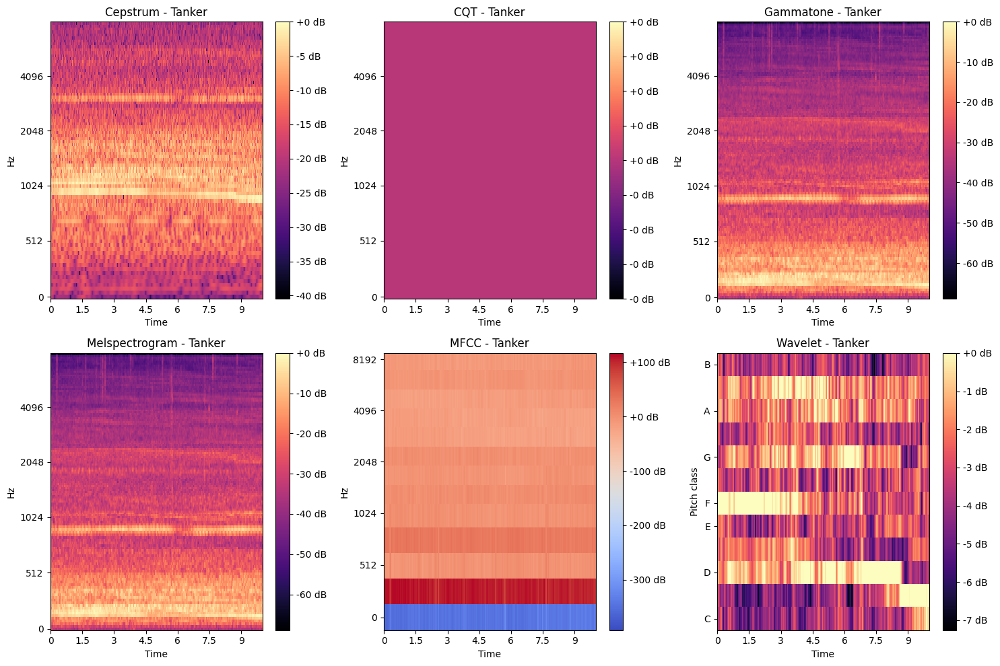

Visualizing features for Trawler: 46__23_07_13_H3_bateero1_chunk1.wav


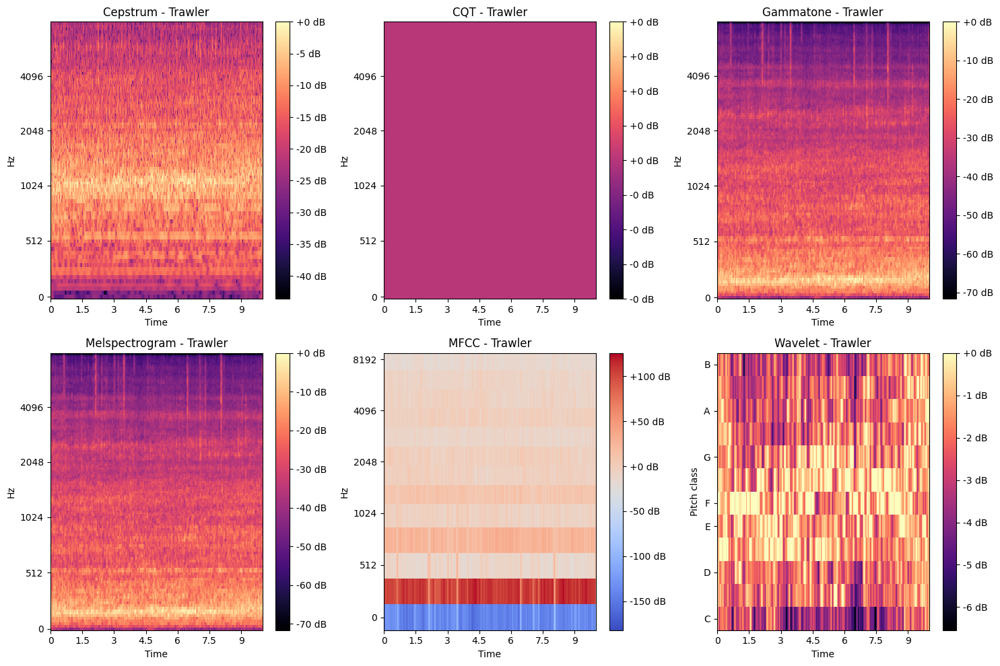

Visualizing features for Natural ambient noise: 81__25_09_13_H3_corriente_chunk1.wav


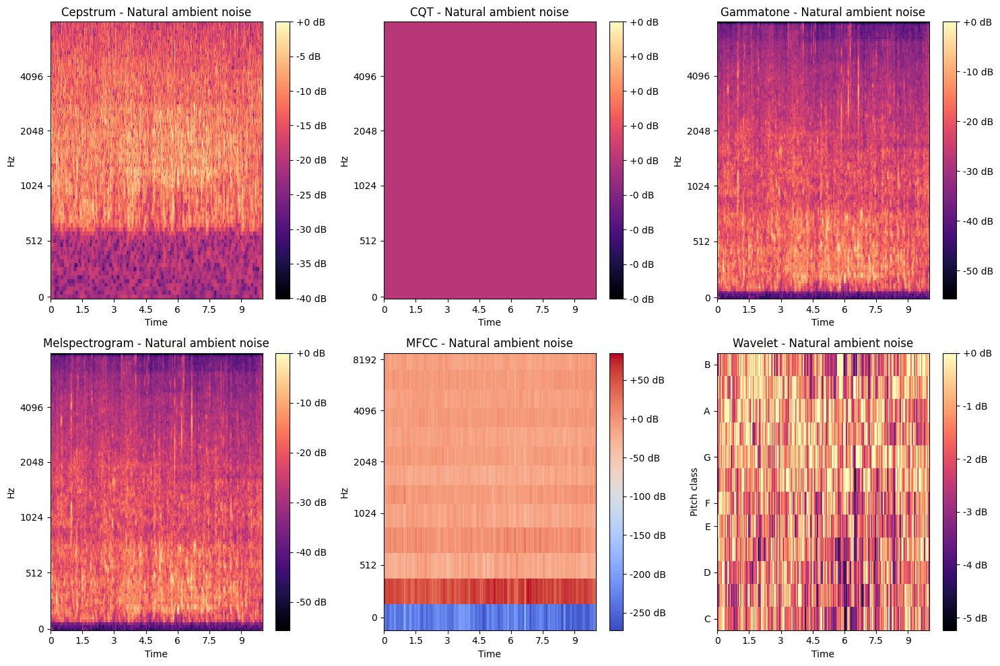

Visualizing features for Tugboat: 16__10_07_13_mscOpera_departure_chunk1.wav


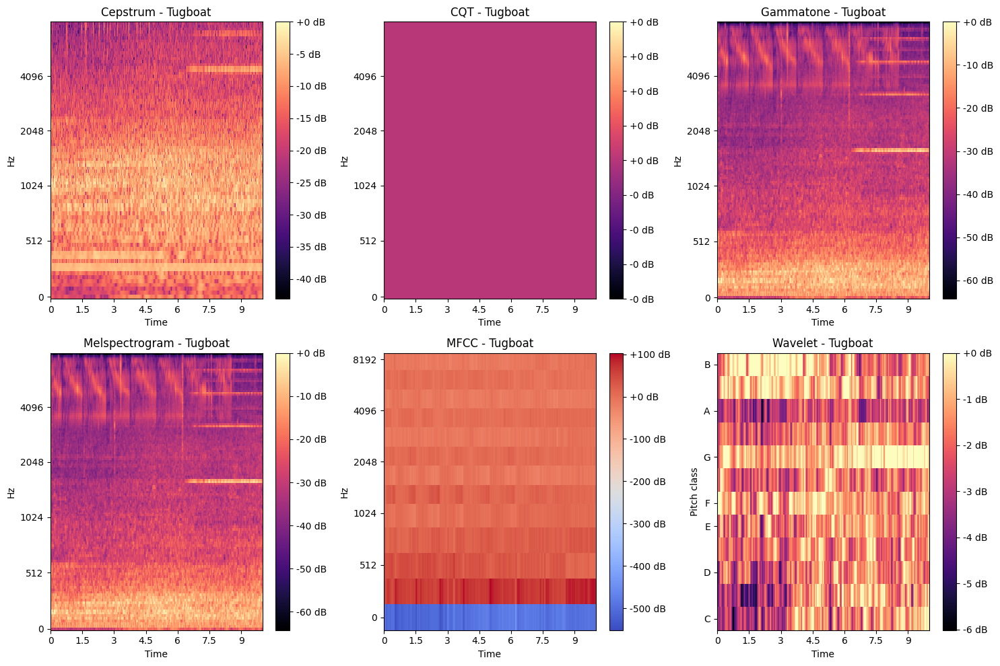

Visualizing features for PilotShip: 06__10_07_13_marDeCangas_Entra_chunk1.wav


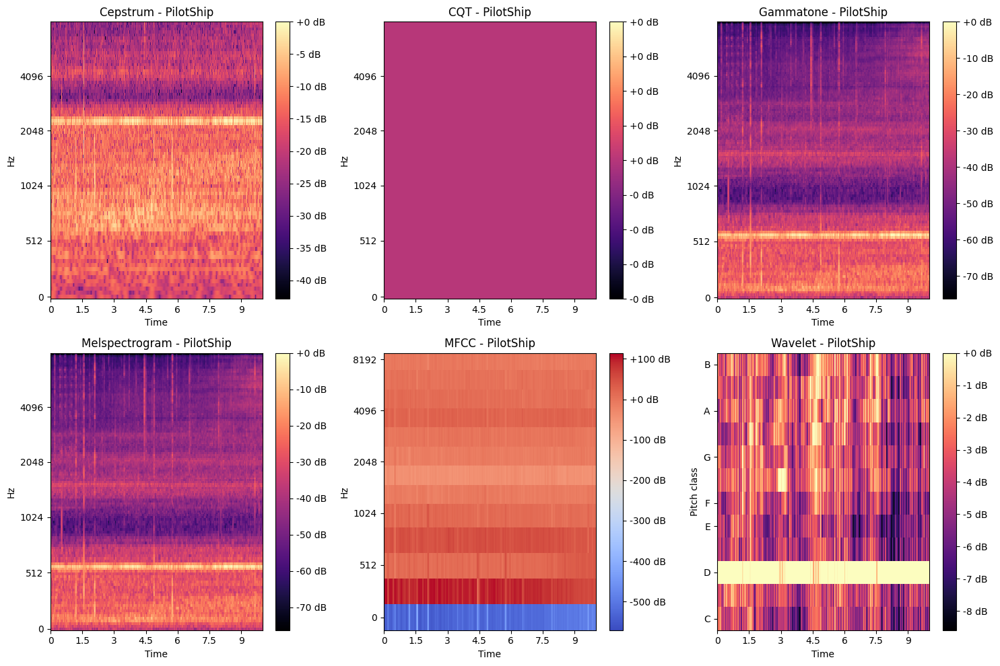

Visualizing features for MusselBoat: 29__19_07_13_practico_chunk1.wav


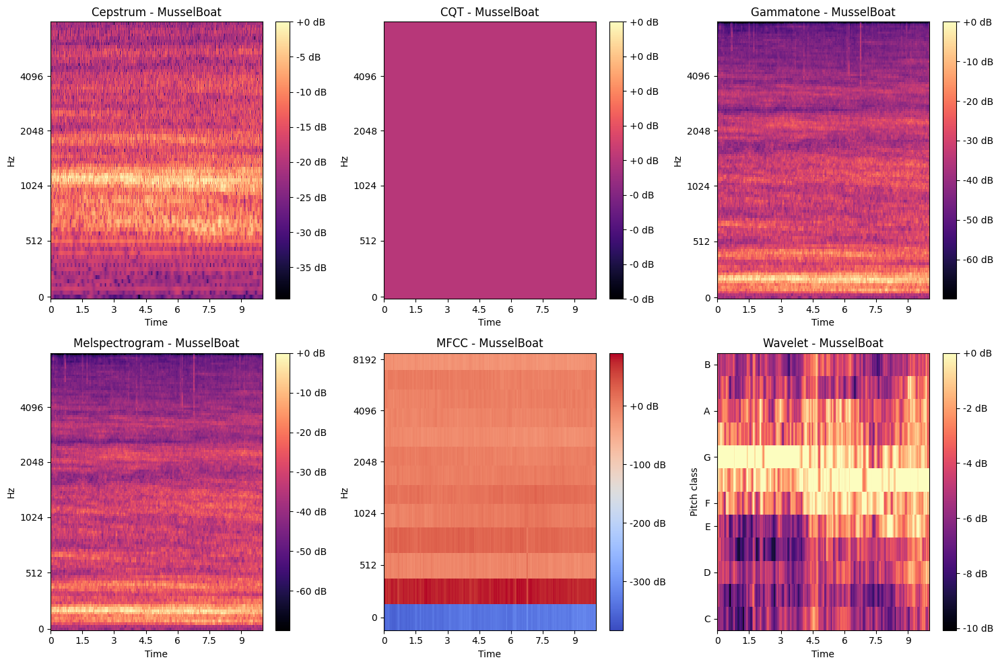

Visualizing features for Cargo: 18__18_07_13_Autopride_entering_chunk1.wav


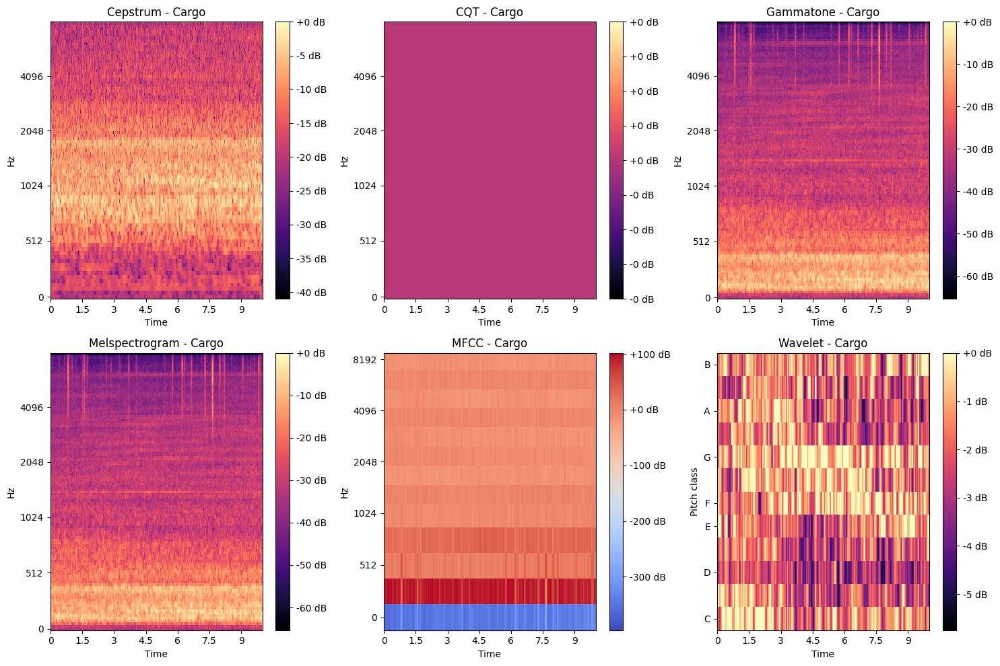

Visualizing features for Sailboat: 37__19_07_13_Velero_Sale_chunk1.wav


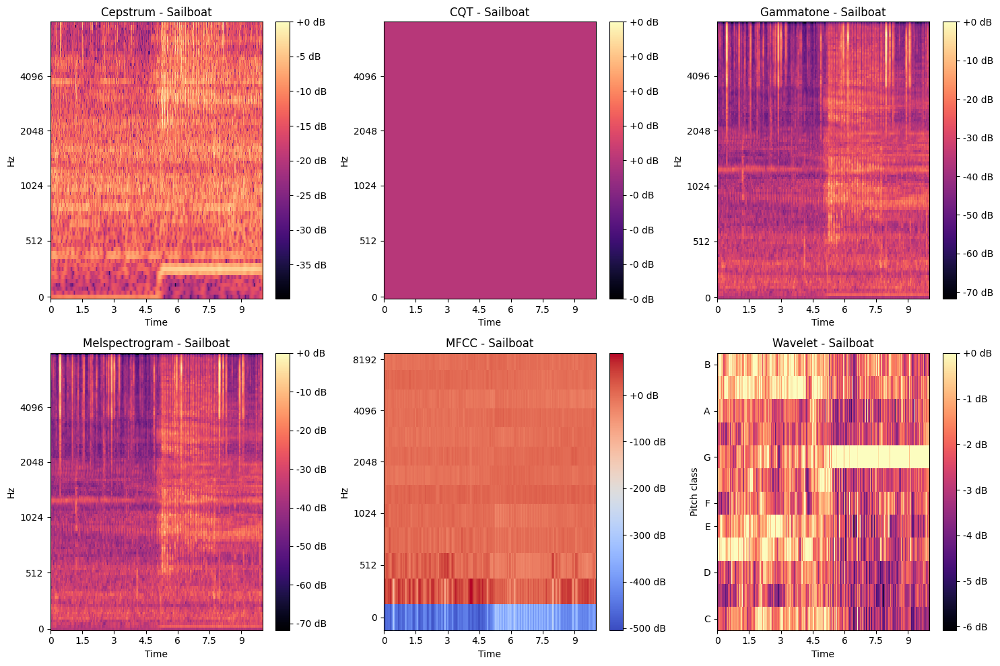

Visualizing features for Passengers: 10_chunk1.wav


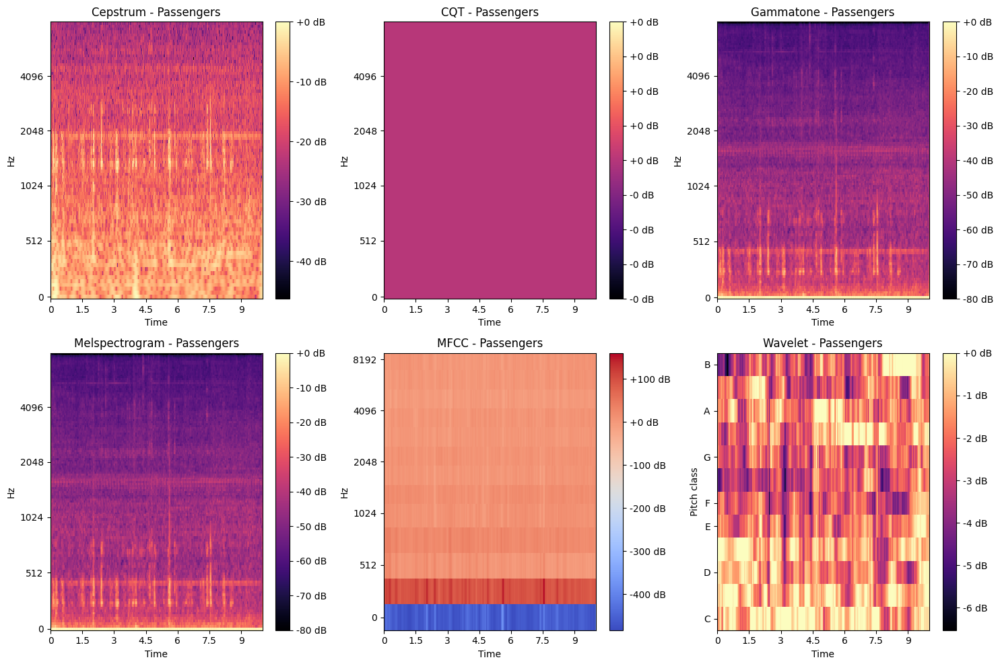

Visualizing features for RORO: 28__19_07_13_NuevoRiaAldan_chunk1.wav


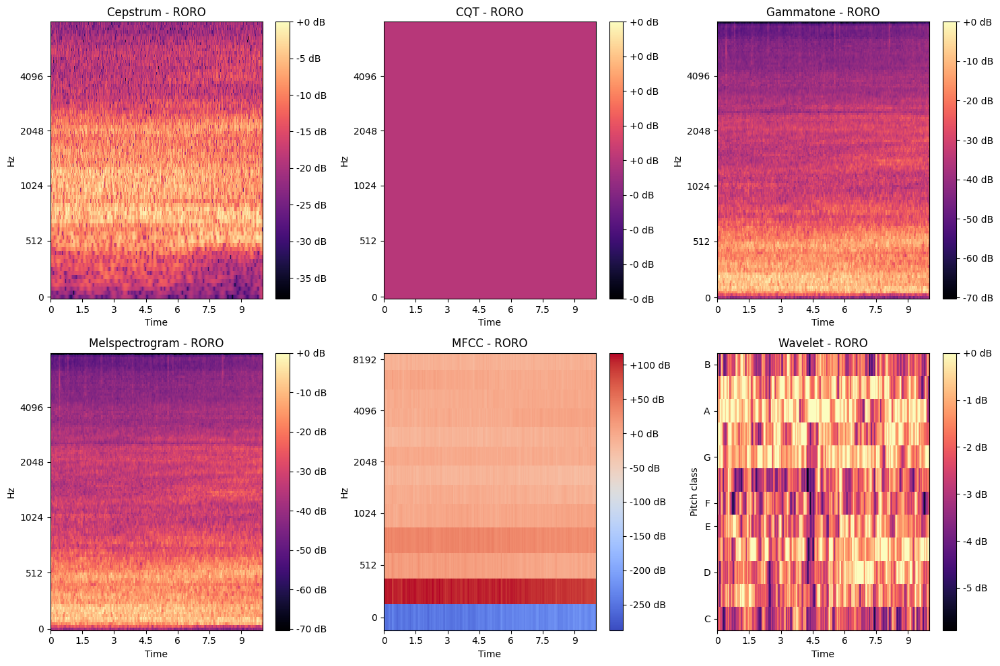

Visualizing features for Fishboat: 15__10_07_13_radaUno_Pasa_chunk1.wav


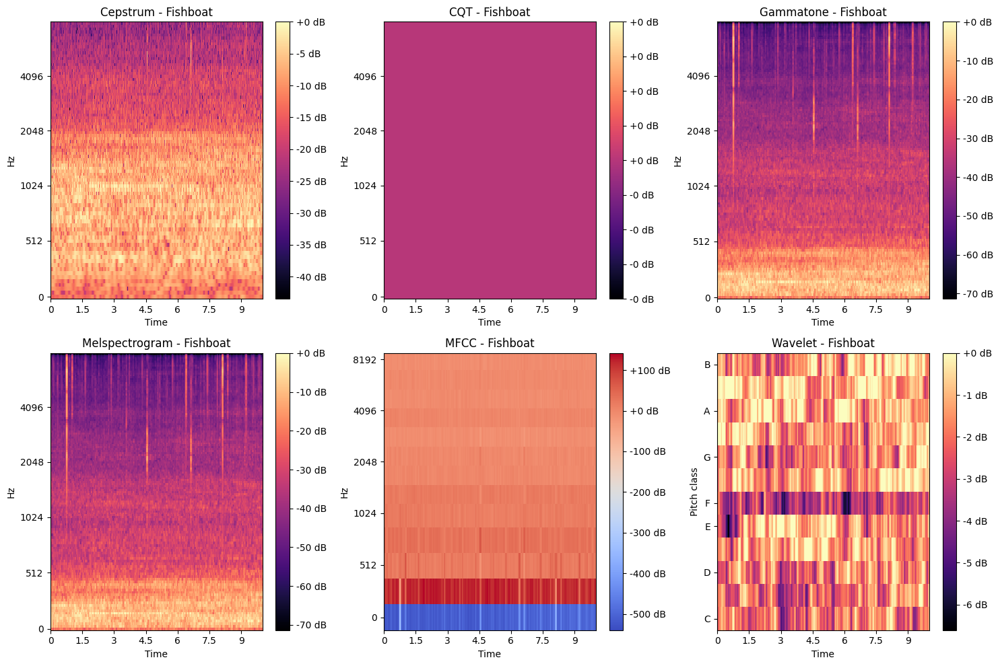

In [3]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import os

# Define class names
classes = ["MotorBoat", "OceanLiner", "Tanker", "Trawler", "Natural ambient noise",
                "Tugboat", "PilotShip", "MusselBoat", "Cargo", "Sailboat",
                "Passengers", "RORO", "Fishboat"]

# Folder paths for each class
folder_paths = [
    r'./Class_ShipsEar/Cargo',
    r'./Class_ShipsEar/Fishboat',
    r'./Class_ShipsEar/Motorboat',
    r'./Class_ShipsEar/MusselBoat',
    r'./Class_ShipsEar/Natural ambient noise',
    r'./Class_ShipsEar/OceanLiner',
    r'./Class_ShipsEar/Passengers',
    r'./Class_ShipsEar/PilotShip',
    r'./Class_ShipsEar/RORO',
    r'./Class_ShipsEar/Sailboat',
    r'./Class_ShipsEar/Tanker',
    r'./Class_ShipsEar/Trawler',
    r'./Class_ShipsEar/Tugboat',
]

# Visualization for feature types
def plot_features(audio_path, class_name):
    # Load audio
    audio, sr = librosa.load(audio_path, sr=None)

    # Generate features choose random audio
    features = {
        "Cepstrum": np.abs(librosa.cqt(audio, sr=sr)),
        "CQT": librosa.amplitude_to_db(librosa.cqt(audio, sr=sr), ref=np.max),
        "Gammatone": librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128, fmax=8000),
        "Melspectrogram": librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128),
        "MFCC": librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13),
        "Wavelet": librosa.feature.chroma_cqt(y=audio, sr=sr)
    }


    # Plot features
    plt.figure(figsize=(15, 10))
    for i, (feature_name, feature_data) in enumerate(features.items(), 1):
        plt.subplot(2, 3, i)
        librosa.display.specshow(
            librosa.power_to_db(feature_data, ref=np.max) if feature_name != "MFCC" else feature_data,
            sr=sr,
            x_axis="time",
            y_axis="mel" if feature_name != "Wavelet" else "chroma"
        )
        plt.title(f"{feature_name} - {class_name}")
        plt.colorbar(format="%+2.0f dB")
    plt.tight_layout()
    plt.show()

# Process one sample per class
for class_name, folder_path in zip(classes, folder_paths):
    # Select the first .wav file in the folder
    audio_files = [file for file in os.listdir(folder_path) if file.endswith('.wav')]
    if audio_files:
        audio_path = os.path.join(folder_path, audio_files[0])
        print(f"Visualizing features for {class_name}: {audio_files[0]}")
        plot_features(audio_path, class_name)
    else:
        print(f"[!] No audio files found in {folder_path}.")


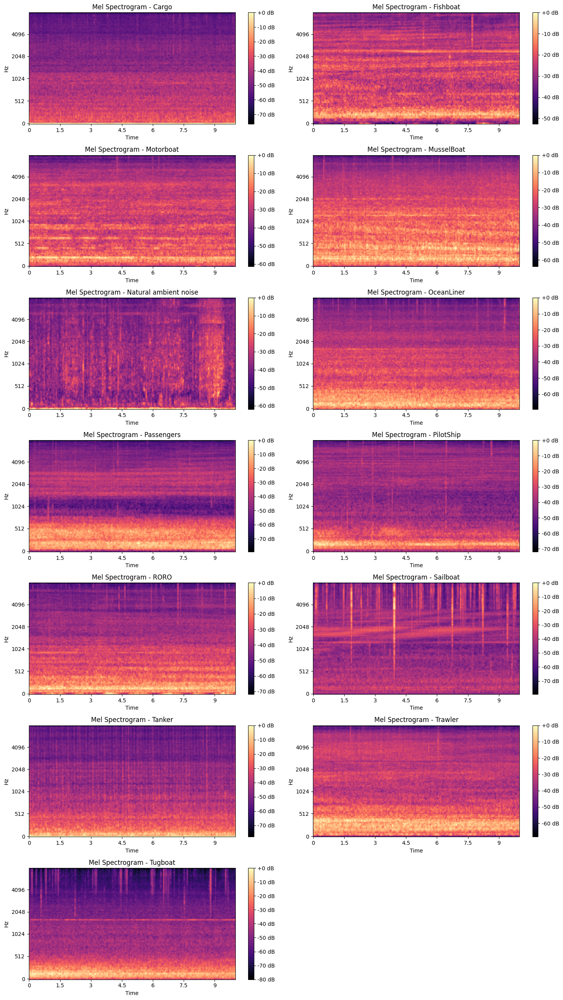

In [4]:
import os
import random
import librosa.display
import matplotlib.pyplot as plt
import numpy as np  # Import numpy for handling arrays
# Folder paths for each class
folder_paths = [
    r'./Class_ShipsEar/Cargo',
    r'./Class_ShipsEar/Fishboat',
    r'./Class_ShipsEar/Motorboat',
    r'./Class_ShipsEar/MusselBoat',
    r'./Class_ShipsEar/Natural ambient noise',
    r'./Class_ShipsEar/OceanLiner',
    r'./Class_ShipsEar/Passengers',
    r'./Class_ShipsEar/PilotShip',
    r'./Class_ShipsEar/RORO',
    r'./Class_ShipsEar/Sailboat',
    r'./Class_ShipsEar/Tanker',
    r'./Class_ShipsEar/Trawler',
    r'./Class_ShipsEar/Tugboat',
]

# Randomly select one file from each class
class_samples = {}

for folder in folder_paths:
    # List all .wav files in the folder
    wav_files = [file for file in os.listdir(folder) if file.endswith('.wav')]
    
    # Select a random .wav file from the list
    random_file = random.choice(wav_files)
    
    # Store the full path of the selected file
    class_samples[folder.split('/')[-1]] = os.path.join(folder, random_file)

# Visualizations for each random file selected
num_classes = len(class_samples)
plt.figure(figsize=(15, num_classes * 2))

# Generate visualizations for each class
for idx, (class_name, file_path) in enumerate(class_samples.items(), 1):
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)
    
    # 1. Mel Spectrogram Heatmap
    mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128)
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
    
    # Plot the Mel Spectrogram
    plt.subplot((num_classes + 1) // 2, 2, idx)  # Dynamic layout
    librosa.display.specshow(mel_spectrogram_db, x_axis='time', y_axis='mel', sr=sr)
    plt.title(f'Mel Spectrogram - {class_name}')
    plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()


c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1075
  warnings.warn(
c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=73
  warnings.warn(


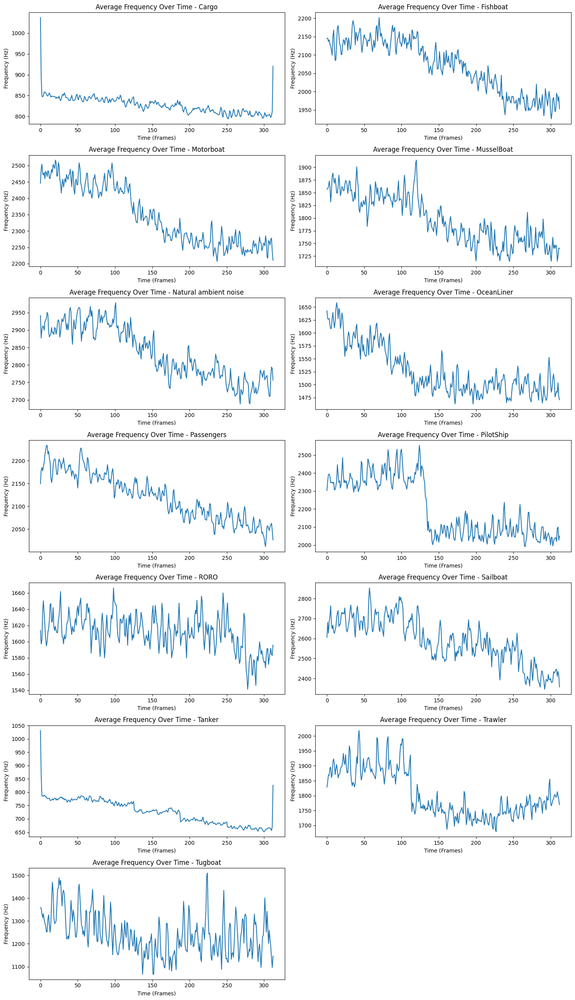

In [5]:
import os
import librosa
import numpy as np
import matplotlib.pyplot as plt

# Folder paths for each class
folder_paths = [
    r'./Class_ShipsEar/Cargo',
    r'./Class_ShipsEar/Fishboat',
    r'./Class_ShipsEar/Motorboat',
    r'./Class_ShipsEar/MusselBoat',
    r'./Class_ShipsEar/Natural ambient noise',
    r'./Class_ShipsEar/OceanLiner',
    r'./Class_ShipsEar/Passengers',
    r'./Class_ShipsEar/PilotShip',
    r'./Class_ShipsEar/RORO',
    r'./Class_ShipsEar/Sailboat',
    r'./Class_ShipsEar/Tanker',
    r'./Class_ShipsEar/Trawler',
    r'./Class_ShipsEar/Tugboat',
]

# Dictionary to store average frequency over time for each class
average_frequencies = {}

# Function to compute average frequency over time from a waveform
def compute_average_frequency(audio, sr, n_fft=2048, hop_length=512):
    # Compute the STFT (Spectrogram) from the waveform
    D = librosa.stft(audio, n_fft=n_fft, hop_length=hop_length)
    
    # Compute the magnitude (absolute value) of the spectrogram
    magnitude = np.abs(D)
    
    # Compute the frequencies associated with each bin of the STFT
    freqs = librosa.fft_frequencies(sr=sr)
    
    # Compute the average frequency for each time frame
    avg_freqs = np.sum(magnitude * freqs[:, np.newaxis], axis=0) / np.sum(magnitude, axis=0)
    
    return avg_freqs

# Function to fix length of feature arrays (pad or trim them)
def fix_length(arr, target_length):
    if len(arr) < target_length:
        return np.pad(arr, (0, target_length - len(arr)), mode='constant', constant_values=0)
    else:
        return arr[:target_length]

# Process all files in each class
for folder in folder_paths:
    class_name = folder.split('/')[-1]
    
    # List all .wav files in the folder
    wav_files = [file for file in os.listdir(folder) if file.endswith('.wav')]
    
    # Initialize an array to accumulate the average frequencies
    average_freqs_all_files = []
    
    for wav_file in wav_files:
        # Load audio file (waveform)
        audio, sr = librosa.load(os.path.join(folder, wav_file), sr=None, duration=10)  # Ensure the file is 10 seconds
        
        # Compute average frequency over time from the waveform
        avg_freqs = compute_average_frequency(audio, sr)
        
        # Store the length of the feature (number of time frames)
        average_freqs_all_files.append(avg_freqs)
    
    # Find the target length (maximum length across all files in the class)
    target_length = max(len(freqs) for freqs in average_freqs_all_files)
    
    # Fix the length of all feature arrays (pad or trim them)
    fixed_length_freqs = [fix_length(freqs, target_length) for freqs in average_freqs_all_files]
    
    # Stack all arrays vertically (to align the frames of the spectrograms)
    stacked_freqs = np.vstack(fixed_length_freqs)
    
    # Compute the average frequency over time for the class (mean across files)
    average_frequency_class = np.mean(stacked_freqs, axis=0)
    
    # Store the average frequency over time for the class
    average_frequencies[class_name] = average_frequency_class

# Visualize the average frequency over time for each class
num_classes = len(average_frequencies)
plt.figure(figsize=(15, num_classes * 2))

# Generate visualizations for each class
for idx, (class_name, avg_freqs) in enumerate(average_frequencies.items(), 1):
    plt.subplot((num_classes + 1) // 2, 2, idx)  # Dynamic layout
    plt.plot(avg_freqs)
    plt.title(f'Average Frequency Over Time - {class_name}')
    plt.xlabel('Time (Frames)')
    plt.ylabel('Frequency (Hz)')

plt.tight_layout()
plt.show()


c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=1075
  warnings.warn(
c:\Users\nurul\flask_project\venv\lib\site-packages\librosa\core\spectrum.py:266: UserWarning: n_fft=2048 is too large for input signal of length=73
  warnings.warn(
C:\Users\nurul\AppData\Local\Temp\ipykernel_6532\2595468136.py:88: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', len(average_frequencies))


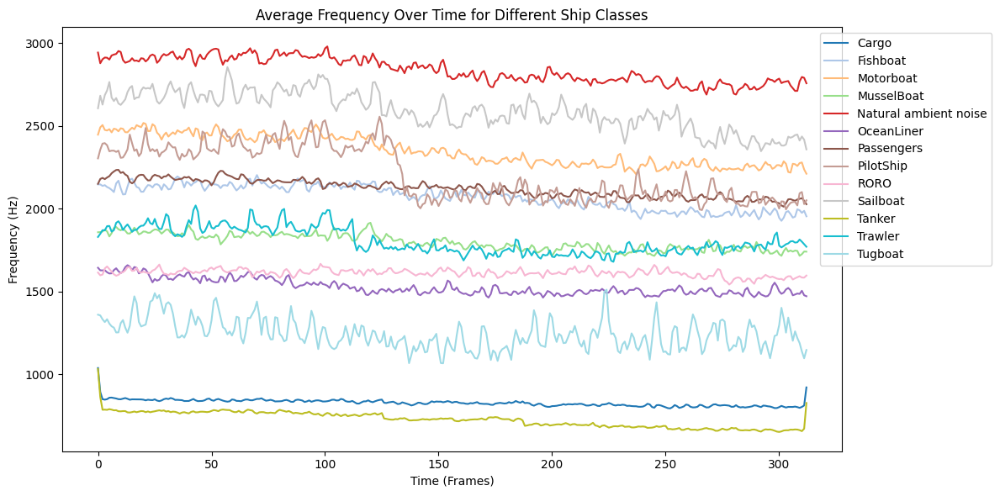

In [1]:
import os
import librosa
import numpy as np
import matplotlib.pyplot as plt

# Folder paths for each class
folder_paths = [
    r'./Class_ShipsEar/Cargo',
    r'./Class_ShipsEar/Fishboat',
    r'./Class_ShipsEar/Motorboat',
    r'./Class_ShipsEar/MusselBoat',
    r'./Class_ShipsEar/Natural ambient noise',
    r'./Class_ShipsEar/OceanLiner',
    r'./Class_ShipsEar/Passengers',
    r'./Class_ShipsEar/PilotShip',
    r'./Class_ShipsEar/RORO',
    r'./Class_ShipsEar/Sailboat',
    r'./Class_ShipsEar/Tanker',
    r'./Class_ShipsEar/Trawler',
    r'./Class_ShipsEar/Tugboat',
]

# Dictionary to store average frequency over time for each class
average_frequencies = {}

# Function to compute average frequency over time from a waveform
def compute_average_frequency(audio, sr, n_fft=2048, hop_length=512):
    # Compute the STFT (Spectrogram) from the waveform
    D = librosa.stft(audio, n_fft=n_fft, hop_length=hop_length)
    
    # Compute the magnitude (absolute value) of the spectrogram
    magnitude = np.abs(D)
    
    # Compute the frequencies associated with each bin of the STFT
    freqs = librosa.fft_frequencies(sr=sr)
    
    # Compute the average frequency for each time frame
    avg_freqs = np.sum(magnitude * freqs[:, np.newaxis], axis=0) / np.sum(magnitude, axis=0)
    
    return avg_freqs

# Function to fix length of feature arrays (pad or trim them)
def fix_length(arr, target_length):
    if len(arr) < target_length:
        return np.pad(arr, (0, target_length - len(arr)), mode='constant', constant_values=0)
    else:
        return arr[:target_length]

# Process all files in each class
for folder in folder_paths:
    class_name = folder.split('/')[-1]
    
    # List all .wav files in the folder
    wav_files = [file for file in os.listdir(folder) if file.endswith('.wav')]
    
    # Initialize an array to accumulate the average frequencies
    average_freqs_all_files = []
    
    for wav_file in wav_files:
        # Load audio file (waveform)
        audio, sr = librosa.load(os.path.join(folder, wav_file), sr=None, duration=10)  # Ensure the file is 10 seconds
        
        # Compute average frequency over time from the waveform
        avg_freqs = compute_average_frequency(audio, sr)
        
        # Store the length of the feature (number of time frames)
        average_freqs_all_files.append(avg_freqs)
    
    # Find the target length (maximum length across all files in the class)
    target_length = max(len(freqs) for freqs in average_freqs_all_files)
    
    # Fix the length of all feature arrays (pad or trim them)
    fixed_length_freqs = [fix_length(freqs, target_length) for freqs in average_freqs_all_files]
    
    # Stack all arrays vertically (to align the frames of the spectrograms)
    stacked_freqs = np.vstack(fixed_length_freqs)
    
    # Compute the average frequency over time for the class (mean across files)
    average_frequency_class = np.mean(stacked_freqs, axis=0)
    
    # Store the average frequency over time for the class
    average_frequencies[class_name] = average_frequency_class

# Combine all the average frequencies into a single plot
plt.figure(figsize=(12, 6))

# Define a color map to ensure each class has a distinct color
colors = plt.cm.get_cmap('tab20', len(average_frequencies))

# Plot the average frequency over time for each class with a different color
for idx, (class_name, avg_freqs) in enumerate(average_frequencies.items()):
    plt.plot(avg_freqs, label=class_name, color=colors(idx))

# Add labels, title, and legend
plt.title('Average Frequency Over Time for Different Ship Classes')
plt.xlabel('Time (Frames)')
plt.ylabel('Frequency (Hz)')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))  # Place the legend outside the plot
plt.tight_layout()
plt.show()


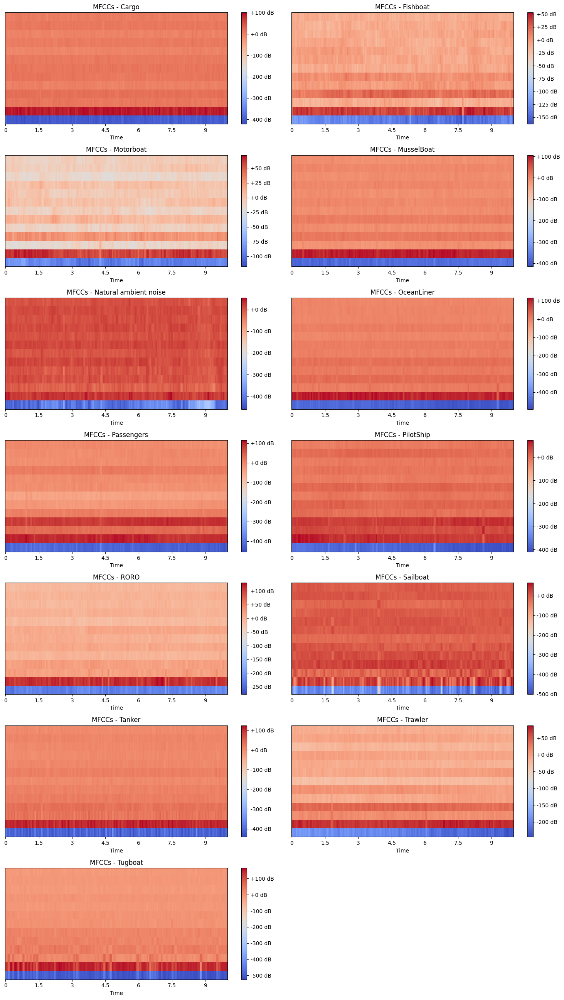

In [5]:
# Reset the figure for other visualizations
num_classes = len(class_samples)
plt.figure(figsize=(15, num_classes * 2))

# Generate other visualizations
for idx, (class_name, file_path) in enumerate(class_samples.items(), 1):
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)
    
    # 2. MFCCs
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13)
    
    # Plot the MFCCs
    plt.subplot((num_classes + 1) // 2, 2, idx) 
    librosa.display.specshow(mfccs, x_axis='time', sr=sr)
    plt.title(f'MFCCs - {class_name}')
    plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

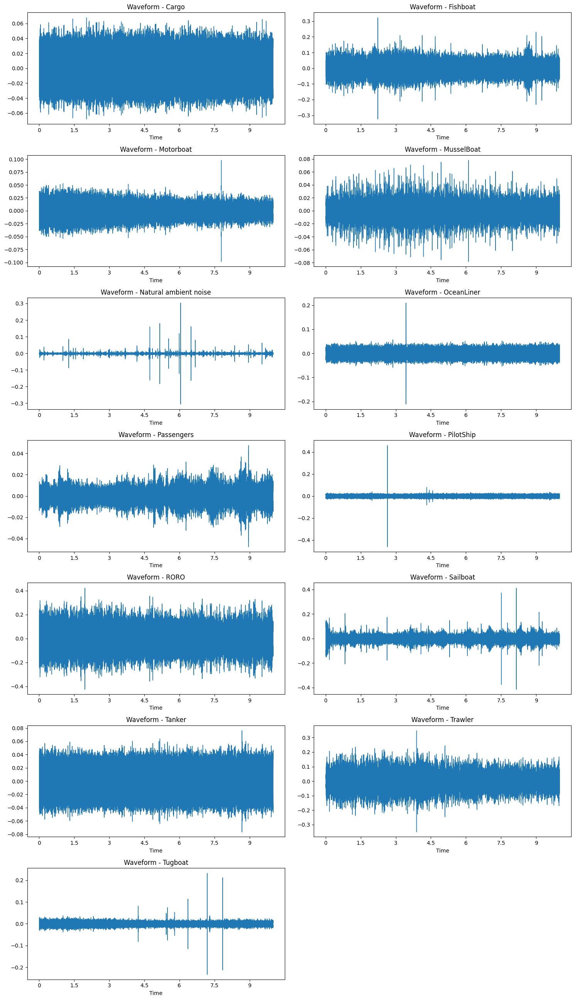

In [12]:
# Reset the figure for other visualizations
num_classes = len(class_samples)
plt.figure(figsize=(15, num_classes * 2))

# Plot the waveform for each class
for idx, (class_name, file_path) in enumerate(class_samples.items(), 1):
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)

    # Plot the waveform
    plt.subplot((num_classes + 1) // 2, 2, idx) 
    librosa.display.waveshow(audio, sr=sr)
    plt.title(f'Waveform - {class_name}')

plt.tight_layout()
plt.show()

C:\Users\nurul\AppData\Local\Temp\ipykernel_6532\1308718189.py:11: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)


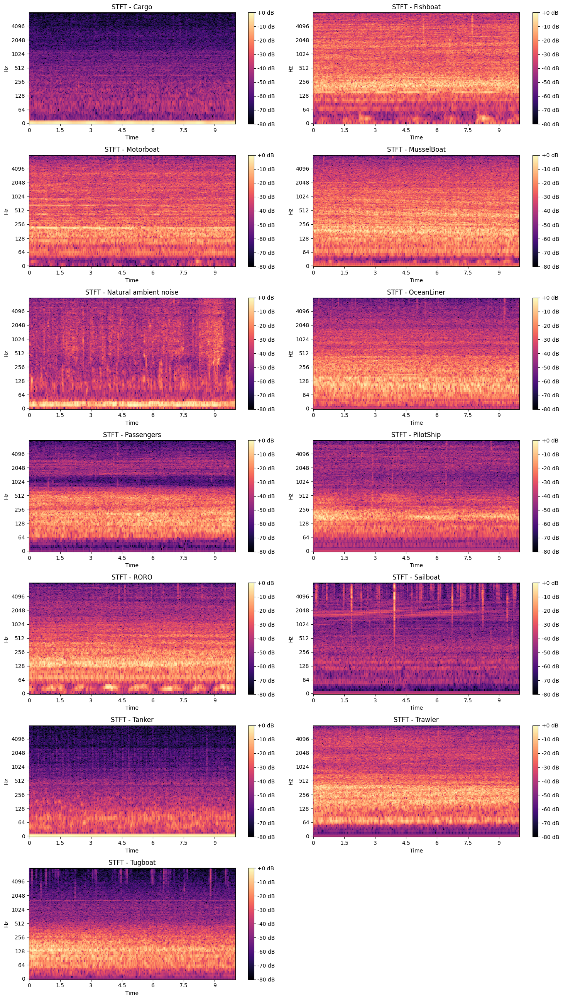

In [6]:
# Reset the figure for other visualizations
num_classes = len(class_samples)
plt.figure(figsize=(15, num_classes * 2))

# Generate other visualizations
for idx, (class_name, file_path) in enumerate(class_samples.items(), 1):
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)
    
    # 2. STFT
    D = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)
    
    # Plot the STFT
    plt.subplot((num_classes + 1) // 2, 2, idx) 
    librosa.display.specshow(D, x_axis='time', y_axis='log', sr=sr)
    plt.title(f'STFT - {class_name}')
    plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()


C:\Users\nurul\AppData\Local\Temp\ipykernel_8280\3877240502.py:11: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)


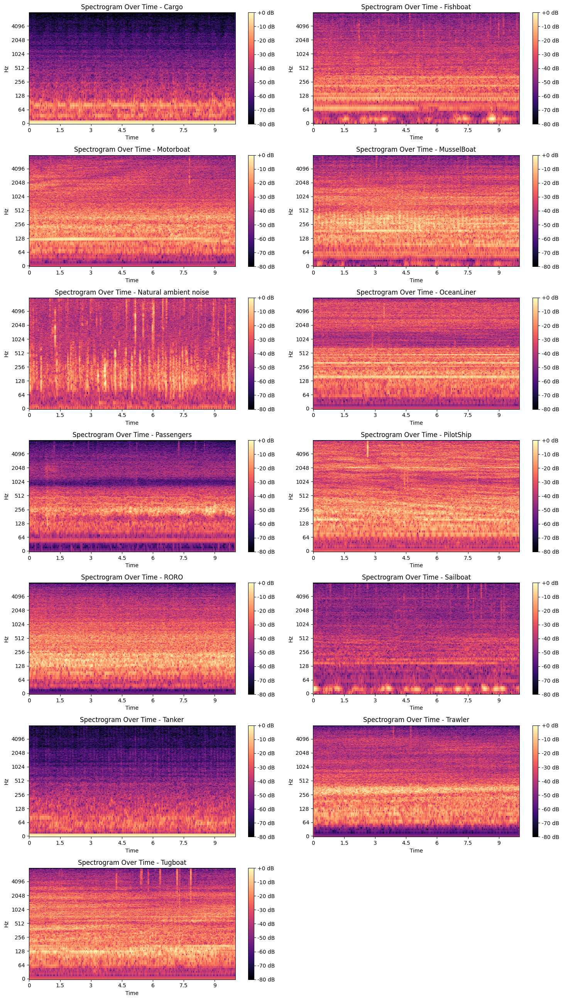

In [13]:

# Reset the figure for other visualizations
num_classes = len(class_samples)
plt.figure(figsize=(15, num_classes * 2))

# Plot the spectrogram for each class
for idx, (class_name, file_path) in enumerate(class_samples.items(), 1):
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)

    # Compute the spectrogram
    D = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)

    # Plot the spectrogram
    plt.subplot((num_classes + 1) // 2, 2, idx) 
    librosa.display.specshow(D, x_axis='time', y_axis='log', sr=sr)
    plt.title(f'Spectrogram Over Time - {class_name}')
    plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

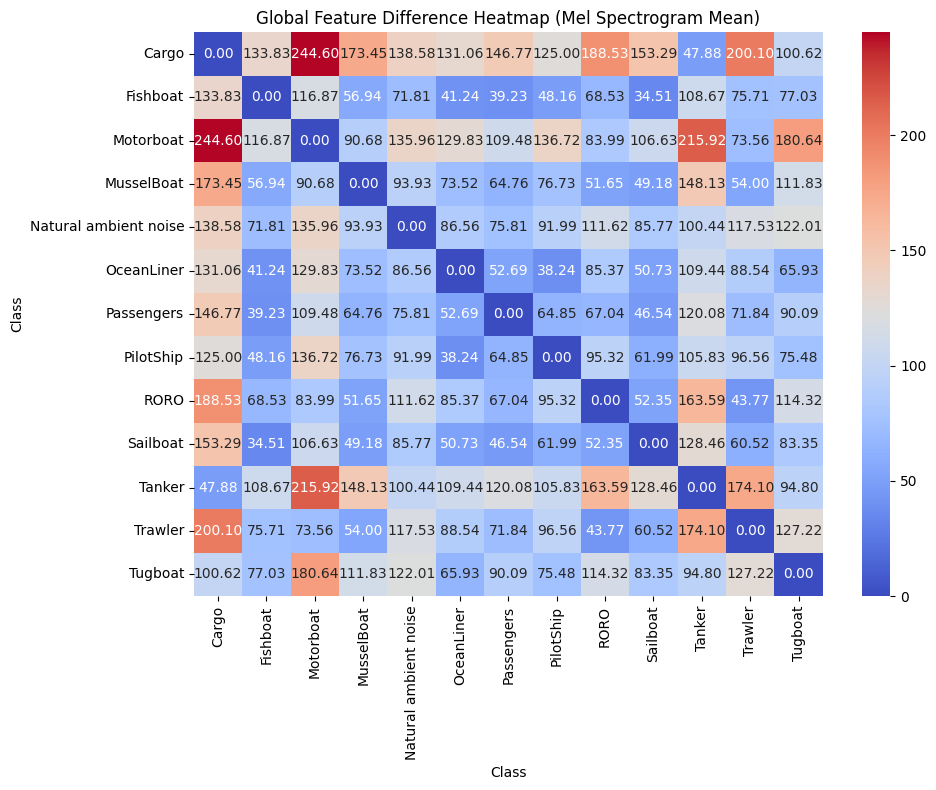

In [15]:
import seaborn as sns

# Function to extract a global feature (e.g., mean of Mel Spectrogram)
def extract_global_features(audio, sr):
    # Compute Mel Spectrogram
    mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128)
    mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
    
    # Extract global feature (mean of the entire spectrogram)
    global_feature = np.mean(mel_spectrogram_db, axis=1)  # Mean across time frames
    return global_feature

# Randomly select one file from each class
class_samples = {}

for folder in folder_paths:
    # List all .wav files in the folder
    wav_files = [file for file in os.listdir(folder) if file.endswith('.wav')]
    
    # Select a random .wav file from the list
    random_file = random.choice(wav_files)
    
    # Store the full path of the selected file
    class_samples[folder.split('/')[-1]] = os.path.join(folder, random_file)

# Dictionary to store global features for each class
global_features = {}

# Process each class sample and extract global features
for class_name, file_path in class_samples.items():
    # Load audio file
    audio, sr = librosa.load(file_path, sr=None)
    
    # Extract global feature (mean of Mel Spectrogram)
    global_feature = extract_global_features(audio, sr)
    
    # Store global features
    global_features[class_name] = global_feature

# Function to compute the Euclidean distance between two global features
def compute_feature_difference(feature1, feature2):
    return np.linalg.norm(feature1 - feature2)

# Create a distance matrix (difference heatmap) for global features
class_names = list(global_features.keys())
distance_matrix = np.zeros((len(class_names), len(class_names)))

# Fill the distance matrix with differences
for i, class1 in enumerate(class_names):
    for j, class2 in enumerate(class_names):
        if i == j:
            distance_matrix[i][j] = 0  # No difference with itself
        else:
            distance_matrix[i][j] = compute_feature_difference(global_features[class1], global_features[class2])

# Create a heatmap using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True, fmt='.2f', cmap='coolwarm', xticklabels=class_names, yticklabels=class_names)
plt.title("Global Feature Difference Heatmap (Mel Spectrogram Mean)")
plt.xlabel("Class")
plt.ylabel("Class")
plt.tight_layout()
plt.show()
